<a href="https://colab.research.google.com/github/tsakailab/sandbox/blob/master/of_ciliary_bests.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')
dl_path="/content/drive/MyDrive/"


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [37]:
data_path = "/content/drive/MyDrive/Colab Notebooks/PCD/"
avi_filename = "20200626_092811 40X.avi"
import cv2
import numpy as np
#read the movie
cap = cv2.VideoCapture(data_path + avi_filename)
nframes = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(nframes)

324


1920 1080 30.0
1080 1920


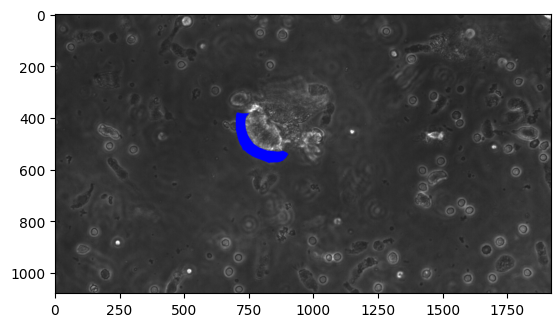

In [38]:
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)
print(width, height, fps)

imsk_filename = "20200626_092811 40X_mask.png"
imsk = cv2.imread(data_path + imsk_filename)
pl, pr, pt, pb = 0,-1,0,-1
plt.imshow(imsk[pt:pb, pl:pr])
aheight, awidth = imsk.shape[0], imsk.shape[1]
print(aheight, awidth)

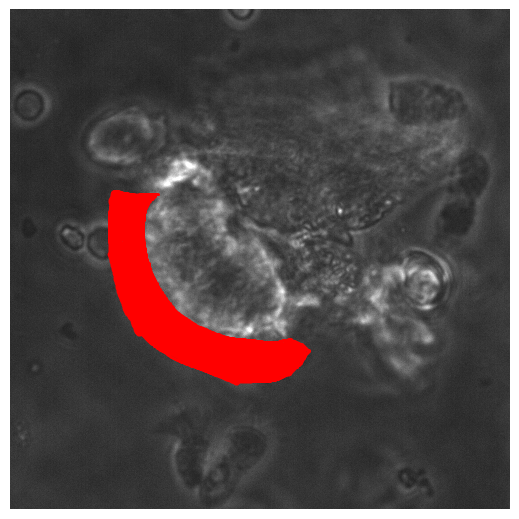

500 500


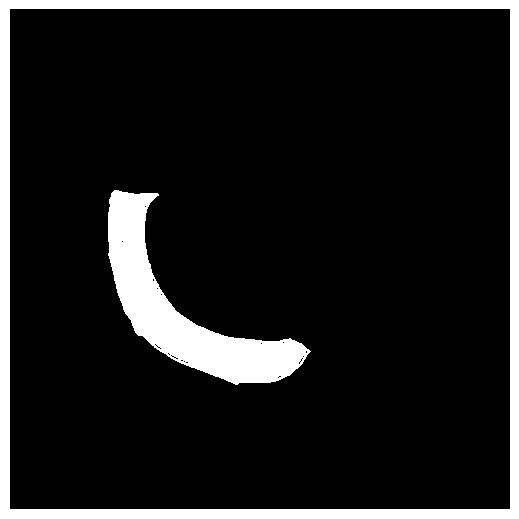

In [81]:
imsk_filename = "20200626_092811 40X_mask.png"
imsk = cv2.imread(data_path + imsk_filename)


pl, pr, pt, pb = 600, 1100, 200, 700


aimsk = imsk[pt:pb, pl:pr]
roi_mask = (aimsk == [0,0,255]).all(axis=2)  # Create a boolean mask for ROI
aimsk = cv2.cvtColor(aimsk, cv2.COLOR_BGR2RGB)

dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")
fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 
plt.imshow(aimsk)
plt.show()

dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")
fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 
plt.imshow(roi_mask, cmap='gray')

aheight, awidth = aimsk.shape[0], aimsk.shape[1]
print(aheight, awidth)

In [31]:
sc = 1

In [40]:
from matplotlib import pyplot as plt

#from google.colab.patches import cv2_imshow
from IPython.display import clear_output

ret, ima = cap.read()
ima = cv2.cvtColor(ima, cv2.COLOR_BGR2GRAY)
ima = ima[pt:pb, pl:pr]
if sc != 1: ima = cv2.resize(ima, (awidth//sc, aheight//sc))

ims = []
flows = []
for i in range(nframes-1):
    ret, imb = cap.read()
    imb = cv2.cvtColor(imb, cv2.COLOR_BGR2GRAY)
    imb = imb[pt:pb, pl:pr]
    if sc != 1: imb = cv2.resize(imb, (imb.shape[1]//sc, imb.shape[0]//sc))

#    '''
    # pyrScale, levels, winsize, iterations, polyN, polySigma, flags
    flow = cv2.calcOpticalFlowFarneback(ima, imb, flow=None,
                                        pyr_scale=0.5, levels=3, winsize=16//sc-1,
                                        iterations=3, poly_n=5, poly_sigma=1.1, flags=0)
    flows.append(flow)
#    '''

    ims.append( ima )
    ima = imb

## Show AVI and optical flow sequence

In [100]:
from matplotlib import animation, rc
from IPython.display import HTML

plts = []

dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")
fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 

for im in ims[:-2]: plts.append([plt.imshow(im, cmap='gray', vmin=0, vmax=255, extent=[0, awidth, 0, aheight])])
#for im in ims[:10]: plt.imshow(im, cmap='gray'); plt.show()
anim_avi = animation.ArtistAnimation(fig, plts, interval=100, blit=True)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
#plt.rcParams['animation.ffmpeg_args'] = 
plt.close(anim_avi._fig)

HTML(anim_avi.to_html5_video())

In [42]:
from matplotlib import animation, rc
from IPython.display import HTML

hsv = np.zeros((aheight, awidth, 3), dtype='uint8')
hsv[...,2] = 255
#hsv = cv2.resize(hsv, (swidth, sheight))

plts = []
#fig = plt.figure()
dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")

fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 

for flow in flows:
    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])
    hsv[...,0] = ang*180/np.pi/2
    hsv[...,1] = mag*32*sc
    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)
    plts.append([plt.imshow(rgb)])

anim_flow = animation.ArtistAnimation(fig, plts, interval=100, blit=True)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
plt.rcParams['animation.embed_limit'] = 100000000
plt.close(anim_flow._fig)

HTML(anim_flow.to_html5_video())

In [101]:
%matplotlib inline
HTML(anim_avi.to_html5_video() + anim_flow.to_html5_video())
#HTML(anim_avi.to_html5_video())
#HTML(anim_flow.to_html5_video())

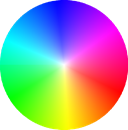

In [102]:
from matplotlib import animation, rc
from IPython.display import HTML

imsk_filename = "20200626_092811 40X_mask.png"
imsk = cv2.imread(data_path + imsk_filename)

imsk = cv2.resize(imsk[pt:pb,pl:pr], (awidth, aheight))
roi_mask = (imsk == [0,0,255]).all(axis=2)  # Create a boolean mask for ROI

plts = []
#fig = plt.figure()
dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")
fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 

for im in ims[:-2]:
    im = im * roi_mask
    plts.append([plt.imshow(im, cmap='gray', vmin=0, vmax=255)])
#for im in ims[:10]: plt.imshow(im, cmap='gray'); plt.show()
anim_avi_mskd = animation.ArtistAnimation(fig, plts, interval=33, blit=True)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
plt.close(anim_avi_mskd._fig)

HTML(anim_avi_mskd.to_html5_video())


In [46]:
from matplotlib import animation, rc
from IPython.display import HTML

imsk_filename = "20200626_092811 40X_mask.png"
imsk = cv2.imread(data_path + imsk_filename)

imsk = cv2.resize(imsk[pt:pb,pl:pr], (awidth, aheight))
roi_mask = (imsk == [0,0,255]).all(axis=2)  # Create a boolean mask for ROI

hsv = np.zeros((aheight, awidth, 3), dtype='uint8')
hsv[...,2] = 255

plts = []
#fig = plt.figure()
dpi = plt.rcParams['figure.dpi']
fig = plt.figure(figsize=(awidth/float(dpi), aheight/float(dpi)))
plt.axis("off")
fig.subplots_adjust(left=0, right=1, bottom=0, top=1) 

tflow = np.stack(flows)
print(tflow.shape)

tflow *= np.expand_dims(np.expand_dims(roi_mask, axis=2), axis=0)

for flow in tflow:
    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])
    hsv[...,0] = ang*180/np.pi/2
    hsv[...,1] = mag*32*sc
    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)
    plts.append([plt.imshow(rgb)])

anim_flow_mskd = animation.ArtistAnimation(fig, plts, interval=100, blit=True)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
plt.close(anim_flow_mskd._fig)

HTML(anim_flow_mskd.to_html5_video())

(323, 500, 500, 2)


In [103]:
HTML(anim_avi_mskd.to_html5_video() + anim_flow_mskd.to_html5_video())

## Features of the optical flow sequence

In [48]:
imsk_filename = "20200626_092811 40X_mask.png"
imsk = cv2.imread(data_path + imsk_filename)

imsk = cv2.resize(imsk[pt:pb,pl:pr], (awidth, aheight))
roi_mask = (imsk == [0,0,255]).all(axis=2)  # Create a boolean mask for ROI

tflow = np.stack(flows)
print(tflow.shape)
tflow *= np.expand_dims(np.expand_dims(roi_mask, axis=2), axis=0)
tmag, tang = cv2.cartToPolar(tflow[...,0], tflow[...,1])

(323, 500, 500, 2)


Random Index: (293, 118)


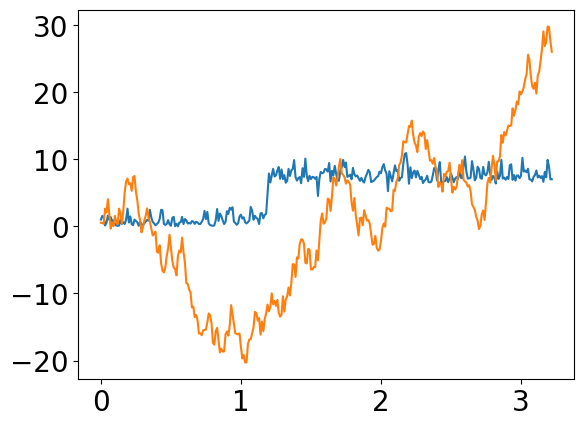

In [84]:
true_indices = np.argwhere(roi_mask)

# Randomly pick an index where the array contains True
random_index = true_indices[np.random.choice(len(true_indices))]

# Extract the row and column from the random index
row, col = random_index

print("Random Index: ({}, {})".format(row, col))

mag = np.unwrap(tmag[:,row,col])
ang = np.unwrap(tang[:,row,col])
t = np.arange(nframes-1)/100
plt.plot(t, mag, t, ang)

In [50]:
!pip -q install EMD-signal
from PyEMD import EMD

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.4/77.4 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.9/132.9 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 9.5 MB/s eta 0:00:00


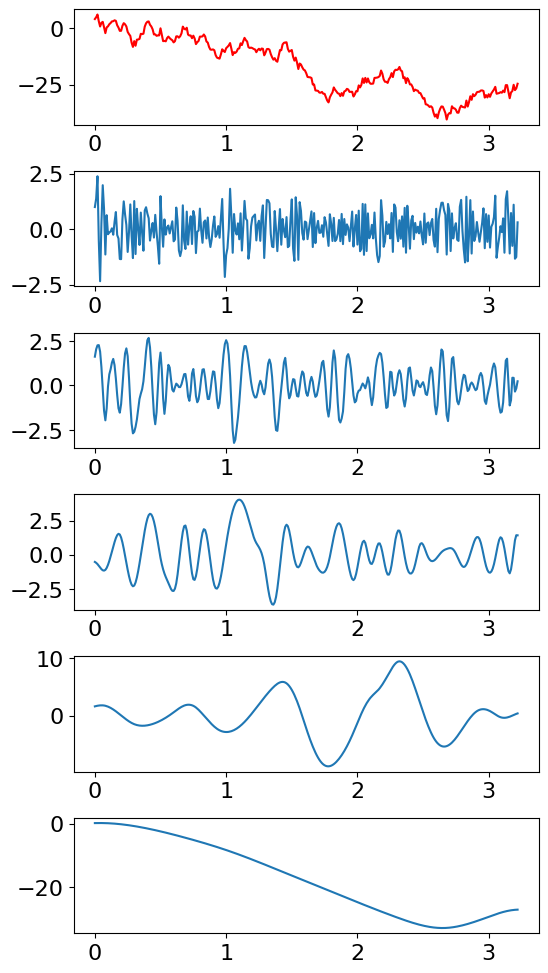

In [99]:
angIMFs = EMD()(ang)
m = len(angIMFs)

fig = plt.figure(figsize=(6,12))
plt.rcParams["font.size"] = 16
plt.subplots_adjust(hspace=0.4)
plt.subplot(m+1, 1, 1)
plt.plot(t, ang, 'r')
for i, aimf in enumerate(angIMFs):
    plt.subplot(m+1, 1, i+2)
    plt.plot(t, aimf)

[ 0.  0.  2.  0.  0.  0. -2.  0.  0.  2.  0.  0.  0. -2.  0.  0.  2.  0.
  0. -2.  0.  0.  2.  0.  0. -2.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.
  0.  0. -2.  0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0. -2.  0.  0.
  0.  0.  2.  0.  0.  0. -2.  0.  2.  0. -2.  0.  2.  0. -2.  0.  0.  0.
  2.  0.  0.  0.  0.  0.  0.  0.  0.  0. -2.  0.  0.  0.  0.  0.  0.  2.
  0.  0.  0.  0.  0.  0.  0.  0.  0. -2.  0.  0.  0.  0.  0.  0.  2.  0.
  0.  0.  0.  0.  0. -2.  0.  0.  0.  0.  0.  0.  2.  0.  0. -2.  2.  0.
 -2.  0.  2.  0. -2.  0.  2.  0. -2.  2.  0.  0. -2.  0.  2.  0.  0.  0.
 -2.  0.  0.  2.  0. -2.  0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0. -2.
  0.  0.  0.  0.  0.  0.  2.  0.  0.  0. -2.  0.  0.  2.  0.  0.  0.  0.
 -2.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  0. -2.  0.  0.  0.  0.  0.
  0.  0.  0.  2.  0.  0.  0. -2.  0.  0.  2.  0. -2.  0.  2.  0.  0. -2.
  0.  0.  0.  2.  0.  0.  0. -2.  0.  0.  0.  2.  0.  0. -2.  0.  2.  0.
 -2.  0.  2.  0.  0. -2.  0.  0.  0.  0.  0.  2.  0

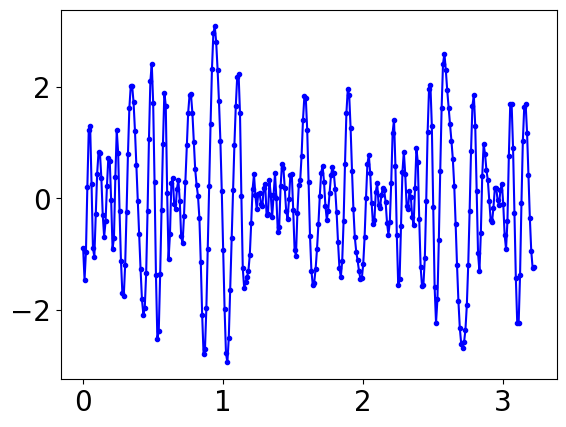

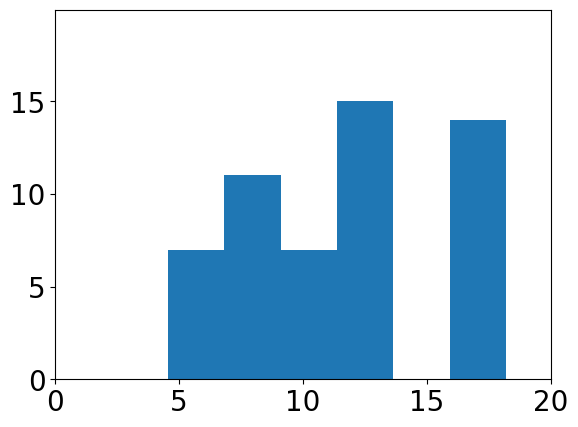

In [86]:
angIMFs = EMD()(ang)
t = np.arange(nframes-1)/100
plt.plot(t, angIMFs[1], 'b.-')

print( np.diff(np.sign(angIMFs[1]))  )
print( np.where( np.diff(np.sign(angIMFs[1])) )[0] )
l = np.diff( np.where( np.diff(np.sign(angIMFs[1])) )[0])
print( l )
#zero_crossings = np.where(np.diff(np.sign(signal)))[0]
# interval_lengths = np.diff(zero_crossings)

f =1./(2*l)*100
plt.figure()
plt.hist(f, bins=20)
plt.xlim([0,20])
plt.show()

In [53]:
def zx_length(signal):

    # Find zero crossing points
    zero_crossings = np.where(np.diff(np.sign(signal)))[0]

    # Calculate lengths of intervals between zero crossing points
    interval_lengths = np.diff(zero_crossings)

    return interval_lengths, zero_crossings

In [105]:
t = np.arange(nframes-1)/100

true_indices = np.argwhere(roi_mask)
lengths = []

plts = []
fig = plt.figure()
plt.axhline(0)
plt.xlim([t.min(), t.max()])

nb = 300
mode = 1
for i in range(nb):
    random_index = true_indices[np.random.choice(len(true_indices))]
    row, col = random_index

    #mag = np.unwrap(tmag[:,row,col])
    ang = np.unwrap(tang[:,row,col])

    angIMFs = EMD()(ang)
    signal = angIMFs[mode]
    l, zx = zx_length(signal)
    lengths.extend(l.tolist())
    plts.extend([ plt.plot(t, signal, 'b.-', t[zx], np.zeros_like(zx), 'ko', markersize=4, markerfacecolor='none', markeredgewidth=1) ])

anim_avi_imf = animation.ArtistAnimation(fig, plts, interval=200, blit=True)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'
plt.close(anim_avi_imf._fig)

HTML(anim_avi_imf.to_html5_video())


85.85781299813272 ms
Median of periods =  80.0 ms ( 12.5 Hz )


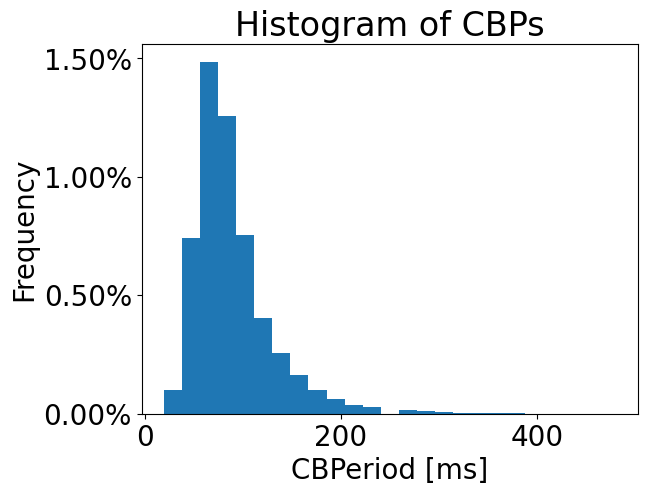

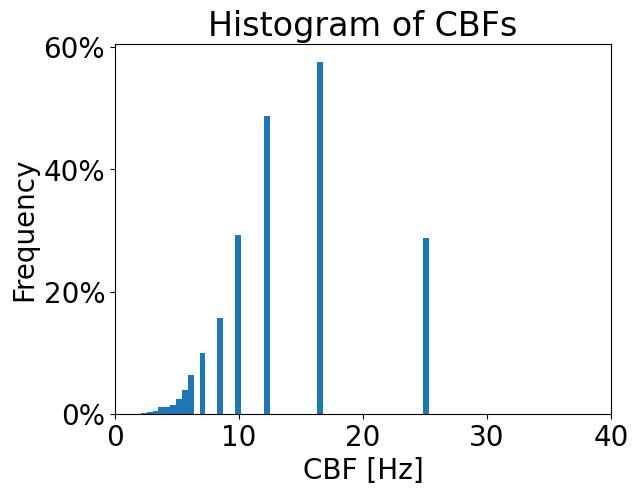

In [106]:
frame_rate = 100

periods = np.array(lengths)*2/frame_rate
meanp = np.mean(periods)
print(meanp*1000, "ms")
#print(meanp*1000, "+/-", np.std(periods)*1000, "ms")
medp = np.median(periods)
print("Median of periods = ", medp*1000, "ms (", 1/medp, "Hz )")

from matplotlib.ticker import PercentFormatter
plt.rcParams["font.size"] = 20
plt.hist(periods*1000, bins=25, histtype='stepfilled', density=True)
plt.gca().yaxis.set_major_formatter(PercentFormatter(1))
#plt.xlim([0,40])
plt.xlabel('CBPeriod [ms]')
plt.ylabel('Frequency')
plt.title('Histogram of CBPs')
plt.show()

f = lambda l: 0.5/l*frame_rate
plt.hist(f(np.array(lengths)), bins='auto', density=True)
plt.gca().yaxis.set_major_formatter(PercentFormatter(1))
plt.xlim([0,40])
plt.xlabel('CBF [Hz]')
plt.ylabel('Frequency')
plt.title('Histogram of CBFs')
plt.show()


85.90399854267238 ms
Median of periods =  80.0 ms ( 12.5 Hz )


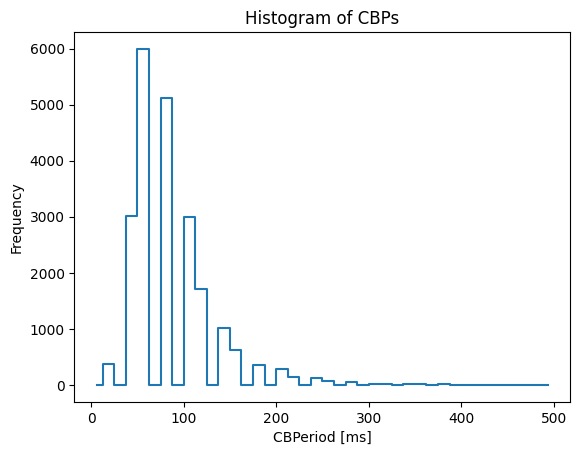

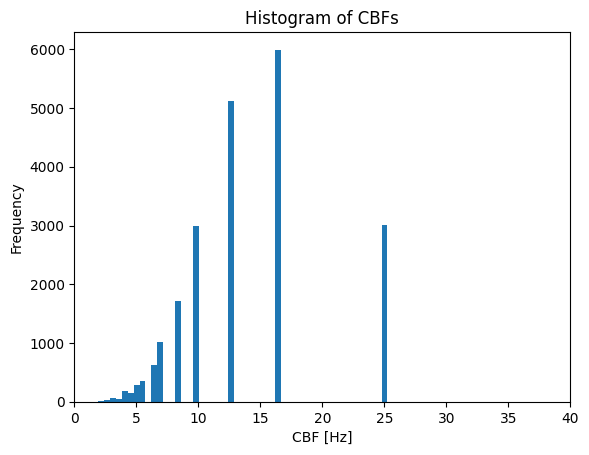

In [57]:
frame_rate = 100

periods = np.array(lengths)*2/frame_rate
meanp = np.mean(periods)
print(meanp*1000, "ms")
#print(meanp*1000, "+/-", np.std(periods)*1000, "ms")
medp = np.median(periods)
print("Median of periods = ", medp*1000, "ms (", 1/medp, "Hz )")

nBins = 40
xlim = [0,500]
n, bins = np.histogram(periods*1000, nBins, xlim)
x = bins[:-1] + 0.5*np.diff(bins)

plt.step(x, n, where='mid')
#plt.xlim([0,40])
plt.xlabel('CBPeriod [ms]')
plt.ylabel('Frequency')
plt.title('Histogram of CBPs')
plt.show()

f = lambda l: 0.5/l*frame_rate
plt.hist(f(np.array(lengths)), bins='auto')
plt.xlim([0,40])
plt.xlabel('CBF [Hz]')
plt.ylabel('Frequency')
plt.title('Histogram of CBFs')
plt.show()


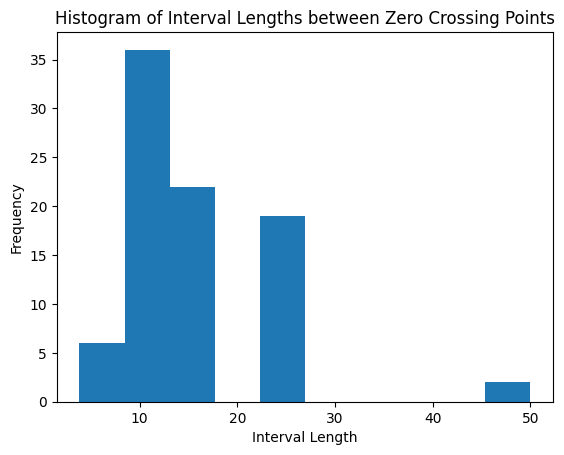

In [ ]:
freqs = zx_freqs(angIMFs[1])
# Plot histogram of interval lengths
plt.hist(freqs, bins=10)
plt.xlabel('Interval Length')
plt.ylabel('Frequency')
plt.title('Histogram of Interval Lengths between Zero Crossing Points')
plt.show()

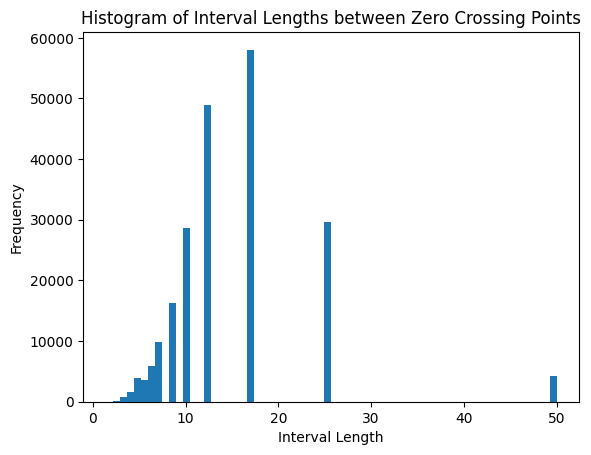

In [ ]:
t = np.arange(nframes-1)/100

true_indices = np.argwhere(roi_mask)
freqs = []
for row, col in true_indices:
    #mag = np.unwrap(tmag[:,row,col])
    ang = np.unwrap(tang[:,row,col])

    angIMFs = EMD()(ang)
    freqs += zx_freqs(angIMFs[1]).tolist()


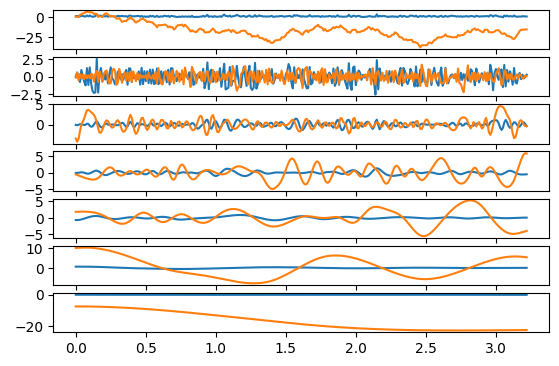

In [ ]:
magIMFs = EMD()(mag)
angIMFs = EMD()(ang)
m = len(magIMFs)
plt.subplot(m+1, 1, 1)
plt.plot(t, mag, t, ang)
for i, (mimf, aimf) in enumerate(zip(magIMFs, angIMFs)):
    plt.subplot(m+1, 1, i+2)
    plt.plot(t, mimf*2, t, aimf)

In [ ]:
!pip -q install pydmd

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.4/81.4 kB 4.5 MB/s eta 0:00:00


In [ ]:
from pydmd import DMD